In [19]:
import numpy as np
import matplotlib.pyplot as plt

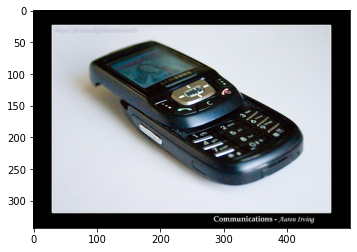

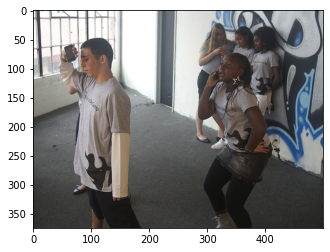

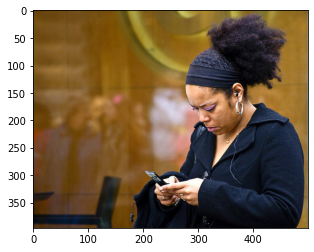

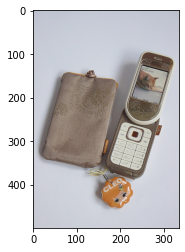

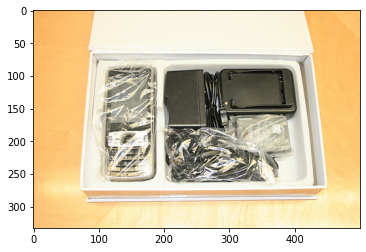

...

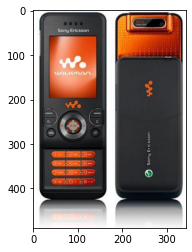

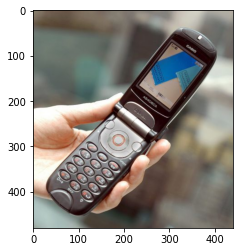

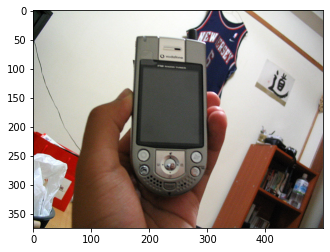

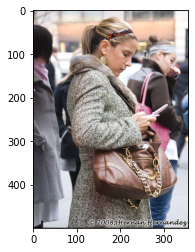

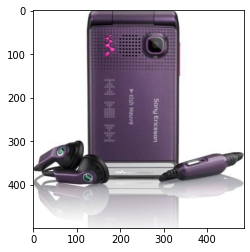

In [36]:
df = pd.read_csv('./data/imagenet_10class/train.csv')
temp = df.tail(38)

for p in temp['rgb_paths']:
    plt.figure()
    a = cv2.imread(p)
    b = cv2.cvtColor(a, cv2.COLOR_RGB2BGR)
    plt.imshow(b)
    plt.show()

In [114]:
fff= glob.glob('./saved_models/Unet-efficientnet-b0-imagenet_sample20k-sample30-inputL/epoch48/*')
fff[:10]

['./saved_models/Unet-efficientnet-b0-imagenet_sample20k-sample30-inputL/epoch48/29.jpg',
 './saved_models/Unet-efficientnet-b0-imagenet_sample20k-sample30-inputL/epoch48/33.jpg',
 './saved_models/Unet-efficientnet-b0-imagenet_sample20k-sample30-inputL/epoch48/22.jpg',
 './saved_models/Unet-efficientnet-b0-imagenet_sample20k-sample30-inputL/epoch48/60.jpg',
 './saved_models/Unet-efficientnet-b0-imagenet_sample20k-sample30-inputL/epoch48/28.jpg',
 './saved_models/Unet-efficientnet-b0-imagenet_sample20k-sample30-inputL/epoch48/12.jpg',
 './saved_models/Unet-efficientnet-b0-imagenet_sample20k-sample30-inputL/epoch48/18.jpg',
 './saved_models/Unet-efficientnet-b0-imagenet_sample20k-sample30-inputL/epoch48/52.jpg',
 './saved_models/Unet-efficientnet-b0-imagenet_sample20k-sample30-inputL/epoch48/48.jpg',
 './saved_models/Unet-efficientnet-b0-imagenet_sample20k-sample30-inputL/epoch48/9.jpg']

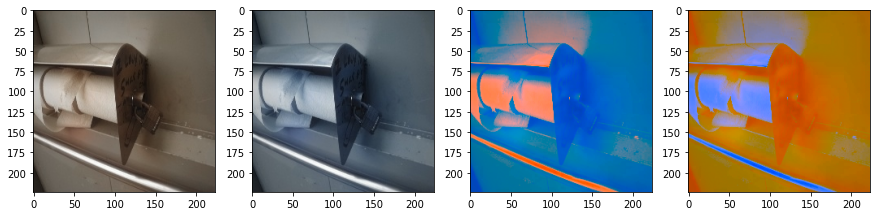

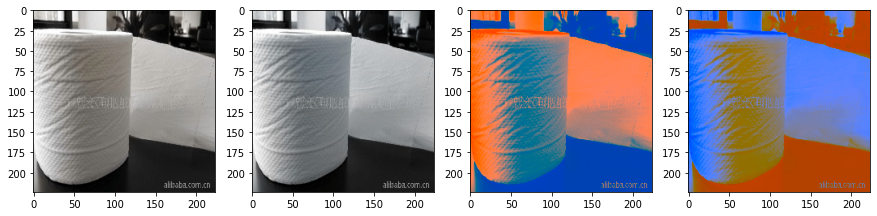

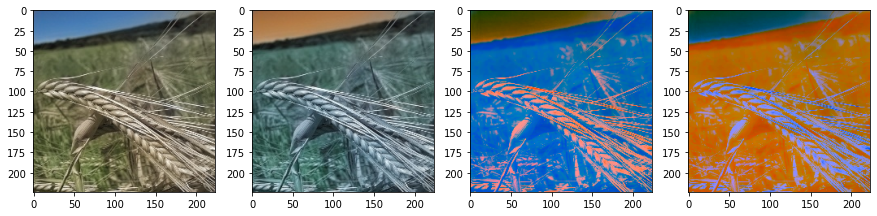

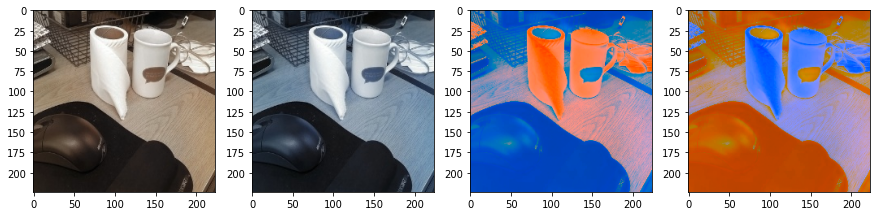

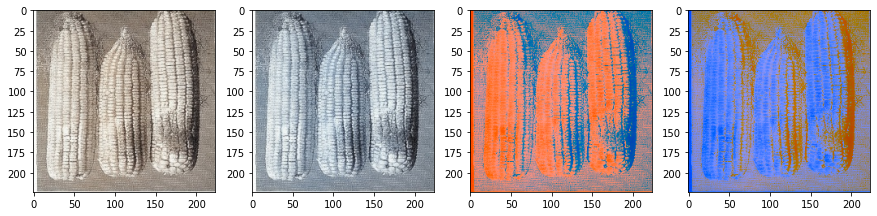

...

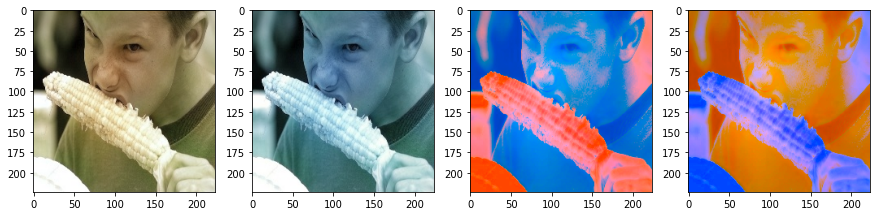

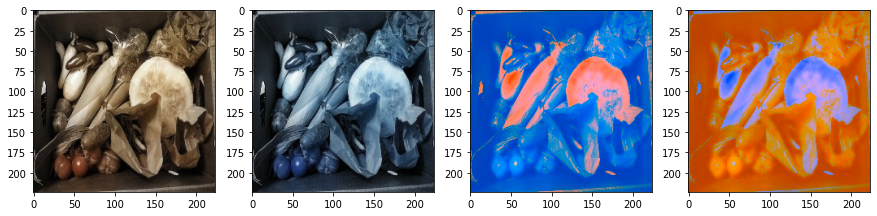

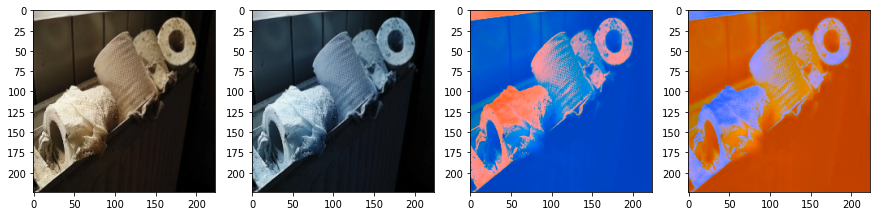

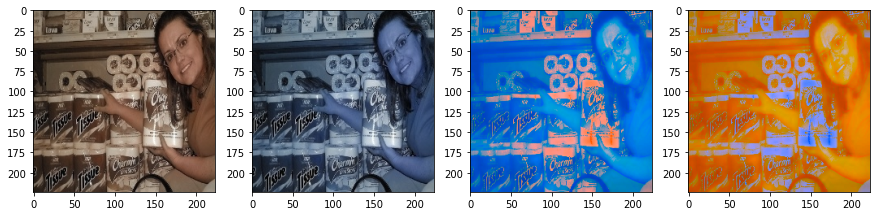

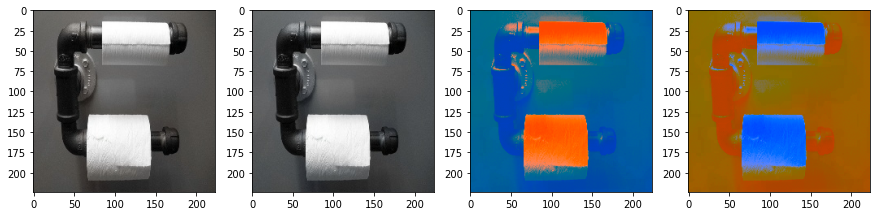

In [115]:
for p in fff:
    plt.figure(figsize=(15,8))
    a = cv2.imread(p)
    b = cv2.cvtColor(a, cv2.COLOR_BGR2RGB)
    c = cv2.cvtColor(a, cv2.COLOR_LAB2RGB)
    d = cv2.cvtColor(a, cv2.COLOR_LAB2BGR)


    
    plt.subplot(1,4,1)
    plt.imshow(a)
    plt.subplot(1,4,2)
    plt.imshow(b)
    plt.subplot(1,4,3)
    plt.imshow(c)
    plt.subplot(1,4,4)
    plt.imshow(d)
    plt.show()

In [116]:
fff= glob.glob('./saved_models/Unet-efficientnet-b0-imagenet_sample20k-sample30-inputL-debug/epoch3/*')
fff[:10]

['./saved_models/Unet-efficientnet-b0-imagenet_sample20k-sample30-inputL-debug/epoch3/29.jpg',
 './saved_models/Unet-efficientnet-b0-imagenet_sample20k-sample30-inputL-debug/epoch3/33.jpg',
 './saved_models/Unet-efficientnet-b0-imagenet_sample20k-sample30-inputL-debug/epoch3/22.jpg',
 './saved_models/Unet-efficientnet-b0-imagenet_sample20k-sample30-inputL-debug/epoch3/60.jpg',
 './saved_models/Unet-efficientnet-b0-imagenet_sample20k-sample30-inputL-debug/epoch3/28.jpg',
 './saved_models/Unet-efficientnet-b0-imagenet_sample20k-sample30-inputL-debug/epoch3/12.jpg',
 './saved_models/Unet-efficientnet-b0-imagenet_sample20k-sample30-inputL-debug/epoch3/18.jpg',
 './saved_models/Unet-efficientnet-b0-imagenet_sample20k-sample30-inputL-debug/epoch3/52.jpg',
 './saved_models/Unet-efficientnet-b0-imagenet_sample20k-sample30-inputL-debug/epoch3/48.jpg',
 './saved_models/Unet-efficientnet-b0-imagenet_sample20k-sample30-inputL-debug/epoch3/9.jpg']

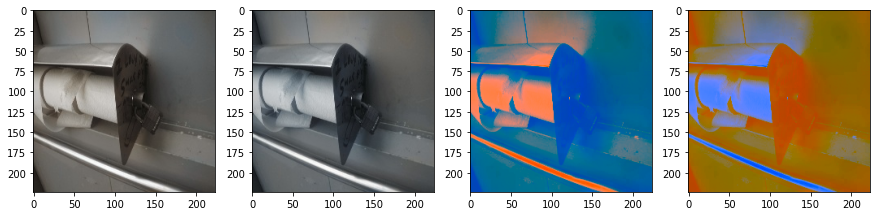

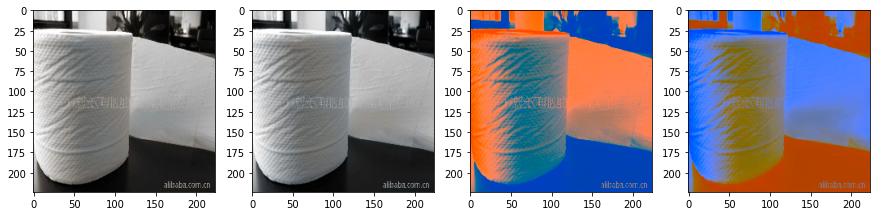

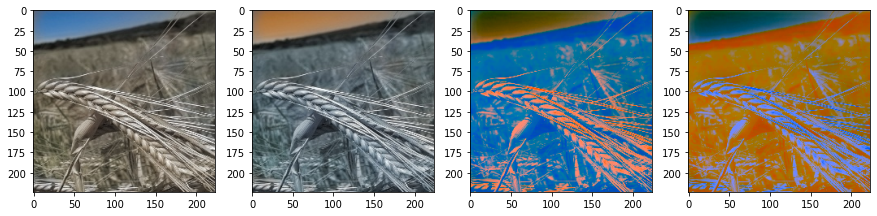

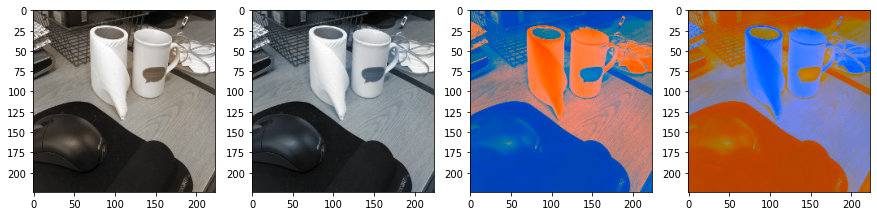

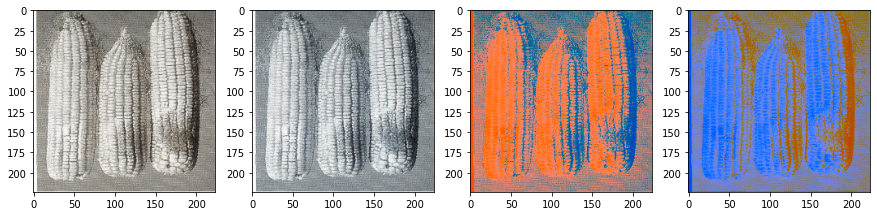

...

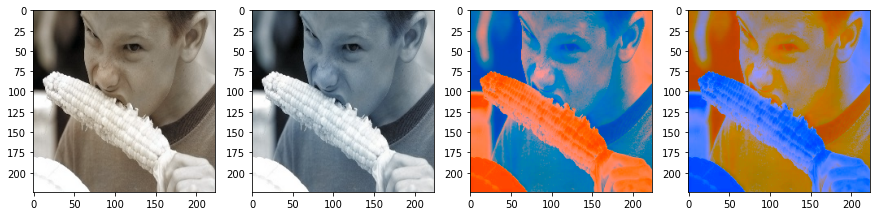

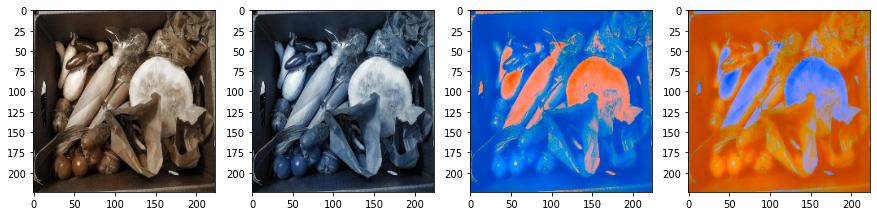

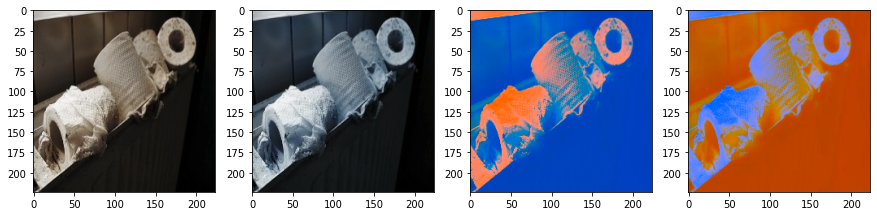

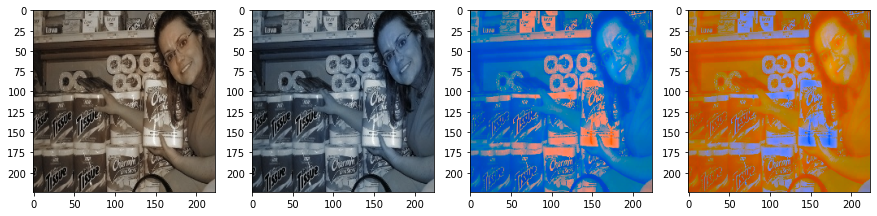

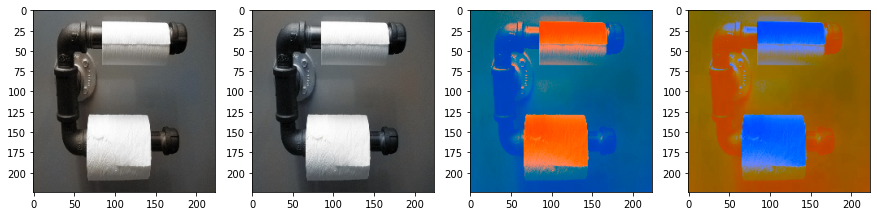

In [119]:
for p in fff:
    plt.figure(figsize=(15,8))
    a = cv2.imread(p)
    b = cv2.cvtColor(a, cv2.COLOR_BGR2RGB)
    c = cv2.cvtColor(a, cv2.COLOR_LAB2RGB)
    d = cv2.cvtColor(a, cv2.COLOR_LAB2BGR)


    
    plt.subplot(1,4,1)
    plt.imshow(a)
    plt.subplot(1,4,2)
    plt.imshow(b)
    plt.subplot(1,4,3)
    plt.imshow(c)
    plt.subplot(1,4,4)
    plt.imshow(d)
    plt.show()

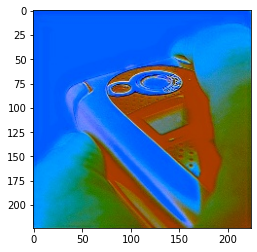

In [37]:
a = cv2.imread('./saved_models/Unet-efficientnet-b4-imagenet_10class-new255/epoch8/1.jpg')
b = cv2.cvtColor(a, cv2.COLOR_RGB2BGR)
plt.imshow(b)

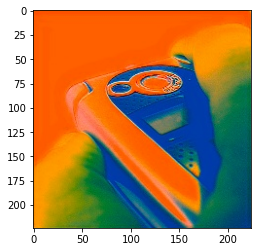

In [38]:
plt.imshow(a)

In [24]:
a[a!=0]

array([1, 1, 1, ..., 1, 1, 1], dtype=uint8)

(array([6.9705e+04, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        8.0751e+04, 0.0000e+00, 0.0000e+00, 0.0000e+00, 7.2000e+01]),
 array([0. , 0.2, 0.4, 0.6, 0.8, 1. , 1.2, 1.4, 1.6, 1.8, 2. ]),
 <BarContainer object of 10 artists>)

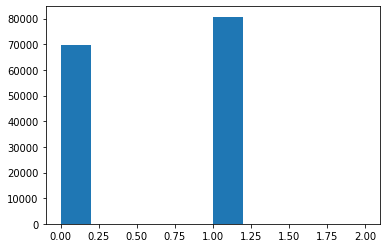

In [25]:
plt.hist(a.reshape(-1))

In [46]:
import glob
import pandas as pd
from sklearn.model_selection import StratifiedKFold, KFold, StratifiedGroupKFold

df = pd.DataFrame()
df['rgb_paths'] = glob.glob('/home/data/imagenet/train/*/*')
df['class'] = df['rgb_paths'].apply(lambda x:x.split('/')[5])


new_df = df.groupby('class').sample(200).reset_index(drop=True)

# make folders
for i in glob.glob('/home/data/imagenet/train/*'):
    os.makedirs(i.replace('imagenet','imagenet20k'))
    
    
# preprocess images
from tqdm import tqdm
for p in tqdm(new_df['rgb_paths']):
    img = cv2.imread(p)
    img = cv2.resize(img, (224,224))
    new_path = p.replace('imagenet','imagenet20k')
    cv2.imwrite(new_path, img)
    
os.makedirs('./data/imagenet_sample20k')


# save csv
skf = KFold(n_splits=5, shuffle=True, random_state=42)

for fold, (train_idx, val_idx) in enumerate(skf.split(new_df)):
    new_df.loc[val_idx, 'fold'] = fold
new_df['rgb_paths'] = new_df['rgb_paths'].apply(lambda x: x.replace('imagenet', 'imagenet20k'))   
new_df.to_csv('./data/imagenet_sample20k/train.csv', index=False)

,rgb_paths,class
0,/home/data/imagenet/train/n02105412/n02105412_...,n02105412
1,/home/data/imagenet/train/n02105412/n02105412_...,n02105412
2,/home/data/imagenet/train/n02105412/n02105412_...,n02105412
3,/home/data/imagenet/train/n02105412/n02105412_...,n02105412
4,/home/data/imagenet/train/n02105412/n02105412_...,n02105412
...,...,...
1281162,/home/data/imagenet/train/n03976657/n03976657_...,n03976657
1281163,/home/data/imagenet/train/n03976657/n03976657_...,n03976657
1281164,/home/data/imagenet/train/n03976657/n03976657_...,n03976657
1281165,/home/data/imagenet/train/n03976657/n03976657_...,n03976657


100%|██████████| 200000/200000 [14:56<00:00, 223.02it/s]
